#Object_Dectection

#Open Images 2019 - Object Detection

**Detect objects in varied and complex images**

https://www.kaggle.com/c/open-images-2019-object-detection/overview

Kaggle에서 데이터 가져오기
--

**참고링크**

1)
https://medium.com/hyunjulie/%EC%BA%90%EA%B8%80%EA%B3%BC-%EA%B5%AC%EA%B8%80-colab-%EC%97%B0%EA%B2%B0%ED%95%B4%EC%A3%BC%EA%B8%B0-6a274f6de81d

2)
https://curioso365.tistory.com/98



In [ ]:
# kaggle api 설치
!pip install kaggle

In [ ]:
# kaggle.json 다운받은 후, 업로드
from google.colab import files
files.upload()

In [3]:
ls -1ha kaggle.json

kaggle.json


In [9]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

In [11]:
#!cp kaggle.json ~/.kaggle/kaggle.json

In [10]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
# 캐글 데이터 다운받기
!kaggle competitions download -c open-images-2019-object-detection

In [7]:
!ls

kaggle.json  sample_data


In [ ]:
!unzip sample_submission.csv.zip

In [14]:
import pandas as pd
df=pd.read_csv("sample_submission.csv")

In [15]:
df

,ImageId,PredictionString
0,b5d912e06f74e948,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
1,be137cf6bb0b62d5,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
2,8d65ca08cb5ce8e8,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
3,4d3ad1e52ad8c065,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
4,9b94408691c7d7bf,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
...,...,...
99994,ed0c79184f3915a5,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
99995,d7395df8121658cf,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
99996,17efc23faebe466b,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...
99997,0dbf51f4a49d5d6d,/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 ...


In [16]:
df.PredictionString[0]

'/m/05s2s 0.9 0.46 0.08 0.93 0.5 /m/0c9ph5 0.5 0.25 0.6 0.6 0.9'

In [17]:
import numpy as np
import os

#for dirname, _, filenames in os.walk('/content'):
#  for filename in filenames:
#    print(os.path.join(dirname, filename))

In [18]:
from PIL import Image
from matplotlib.pyplot import imshow

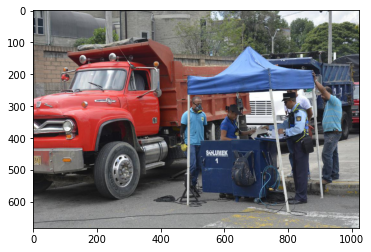

In [19]:
img_1=Image.open('/content/00000b4dcff7f799.jpg')
imshow(np.asarray(img_1))

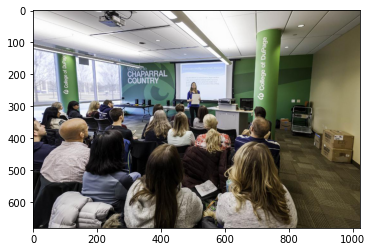

In [20]:
img_2=Image.open('/content/00001a21632de752.jpg')
imshow(np.asarray(img_2))

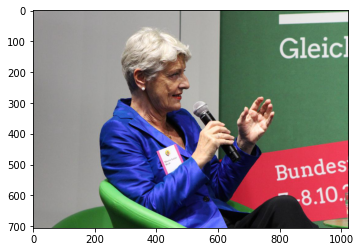

In [21]:
img_3=Image.open('/content/0005facd8dbaf39a.jpg')
imshow(np.asarray(img_3))

In [22]:
print(np.asarray(img_1).shape)
print(np.asarray(img_2).shape)
print(np.asarray(img_3).shape)

(683, 1024, 3)
(681, 1024, 3)
(706, 1024, 3)


Intro to TF Hub for Object Detection
--

https://www.kaggle.com/jian1201/intro-to-tf-hub-for-object-detection

In [24]:
from pprint import pprint
import tensorflow_hub as hub
from PIL import Image, ImageColor, ImageDraw, ImageFont, ImageOps
from tqdm import tqdm
import tensorflow as tf
import tensorflow.compat.v1 as tfv

In [25]:
def format_prediction_string(image_id, result):
    prediction_strings = []
    
    for i in range(len(result['detection_scores'])):
        class_name = result['detection_class_names'][i].decode("utf-8")
        YMin,XMin,YMax,XMax = result['detection_boxes'][i]
        score = result['detection_scores'][i]
        
        prediction_strings.append(
            f"{class_name} {score} {XMin} {YMin} {XMax} {YMax}"
        )
        
    prediction_string = " ".join(prediction_strings)

    return {
        "ImageID": image_id,
        "PredictionString": prediction_string
    }

In [26]:
def display_image(image):
    fig = plt.figure(figsize=(20, 15))
    plt.grid(False)
    plt.axis('off')
    plt.imshow(image)

In [27]:
def draw_bounding_box_on_image(image,
                               ymin,
                               xmin,
                               ymax,
                               xmax,
                               color,
                               font,
                               thickness=4,
                               display_str_list=()):
    """Adds a bounding box to an image."""
    draw = ImageDraw.Draw(image)
    im_width, im_height = image.size
    (left, right, top, bottom) = (xmin * im_width, xmax * im_width,
                                  ymin * im_height, ymax * im_height)
    draw.line([(left, top), (left, bottom), (right, bottom), (right, top),
               (left, top)],
              width=thickness,
              fill=color)

    display_str_heights = [font.getsize(ds)[1] for ds in display_str_list]
    total_display_str_height = (1 + 2 * 0.05) * sum(display_str_heights)

    if top > total_display_str_height:
        text_bottom = top
    else:
        text_bottom = bottom + total_display_str_height
    for display_str in display_str_list[::-1]:
        text_width, text_height = font.getsize(display_str)
        margin = np.ceil(0.05 * text_height)
        draw.rectangle([(left, text_bottom - text_height - 2 * margin),
                        (left + text_width, text_bottom)],
                       fill=color)
        draw.text((left + margin, text_bottom - text_height - margin),
                  display_str,
                  fill="black",
                  font=font)
        text_bottom -= text_height - 2 * margin

In [28]:
def draw_boxes(image, boxes, class_names, scores, max_boxes=10, min_score=0.1):
    colors = list(ImageColor.colormap.values())

    try:
        font = ImageFont.truetype(
            "/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Regular.ttf",
            25)
    except IOError:
        print("Font not found, using default font.")
        font = ImageFont.load_default()

    for i in range(min(boxes.shape[0], max_boxes)):
        if scores[i] >= min_score:
            ymin, xmin, ymax, xmax = tuple(boxes[i].tolist())
            display_str = "{}: {}%".format(class_names[i].decode("ascii"),
                                           int(100 * scores[i]))
            color = colors[hash(class_names[i]) % len(colors)]
            image_pil = Image.fromarray(np.uint8(image)).convert("RGB")
            draw_bounding_box_on_image(
                image_pil,
                ymin,
                xmin,
                ymax,
                xmax,
                color,
                font,
                display_str_list=[display_str])
            np.copyto(image, np.array(image_pil))
    return image

In [31]:
sample_image_path='/content/00000b4dcff7f799.jpg'

with tfv.Graph().as_default():
    image_string_placeholder = tfv.placeholder(tf.string)
    decoded_image = tfv.image.decode_jpeg(image_string_placeholder)
    decoded_image_float = tfv.image.convert_image_dtype(
        image=decoded_image, dtype=tfv.float32
    )
    image_tensor = tfv.expand_dims(decoded_image_float, 0)

    model_url = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"
    detector = hub.Module(model_url)
    detector_output = detector(image_tensor, as_dict=True)
    
    init_ops = [tfv.global_variables_initializer(), tfv.tables_initializer()]
    sess = tfv.Session()
    sess.run(init_ops)

    with tfv.gfile.Open(sample_image_path, "rb") as binfile:
        image_string = binfile.read()

    result_out, image_out = sess.run(
        [detector_output, decoded_image],
        feed_dict={image_string_placeholder: image_string}
    )

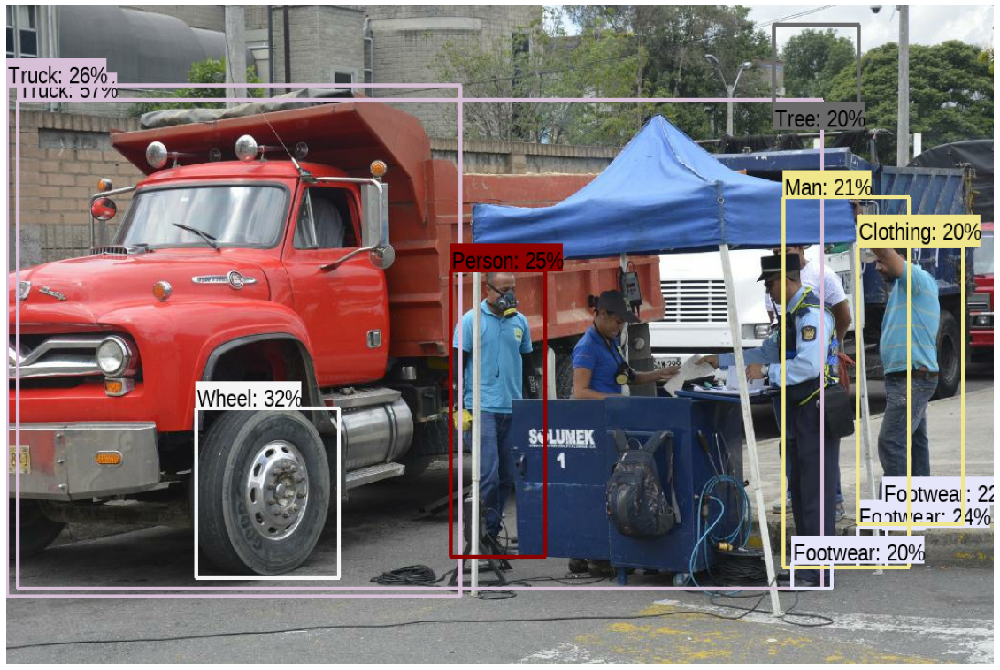

In [44]:
image_with_boxes = draw_boxes(
    np.array(image_out), result_out["detection_boxes"],
    result_out["detection_class_entities"], result_out["detection_scores"]
)
display_image(image_with_boxes)

#인공지능 그랜드챌린지 Sample Data Object Detection

In [14]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [35]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [36]:
import warnings
warnings.filterwarnings('ignore')

In [37]:
from PIL import Image, ImageColor, ImageDraw, ImageFont, ImageOps
from matplotlib.pyplot import imshow

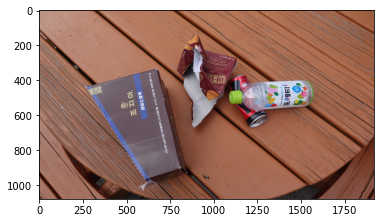

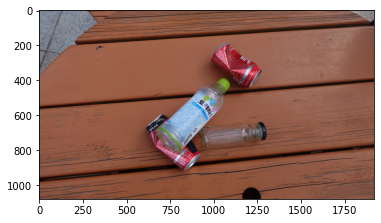

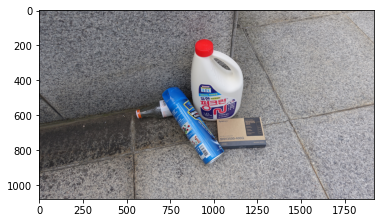

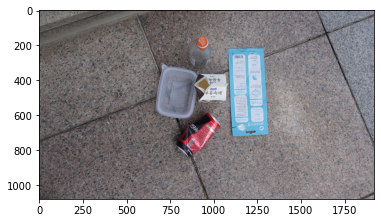

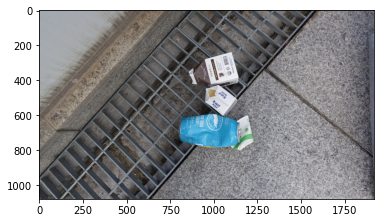

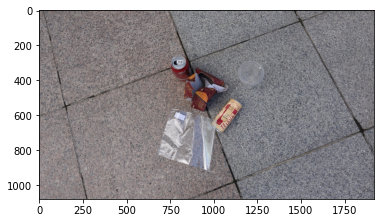

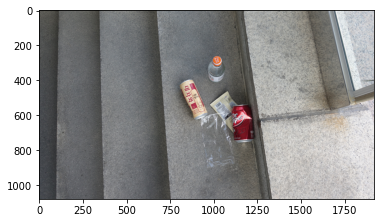

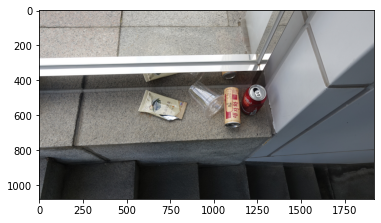

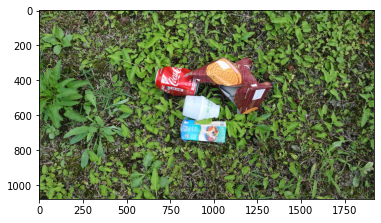

In [22]:
for i in range(1,10):
  img=Image.open('/content/drive/MyDrive/DATA/dataset_4차_트랙3_sample/t3_000{}.JPG'.format(i))
  imshow(np.asarray(img))
  plt.show()

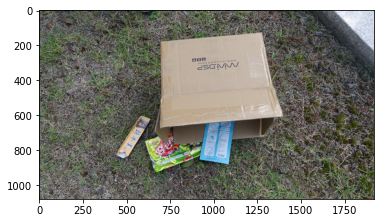

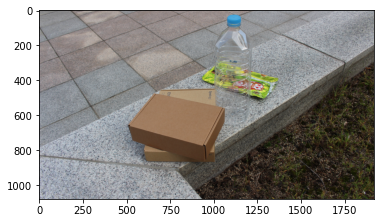

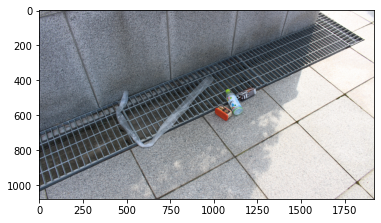

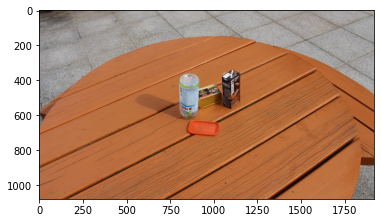

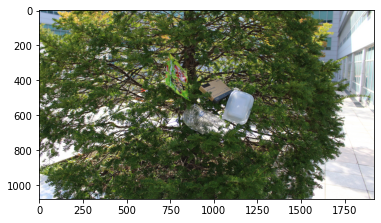

...

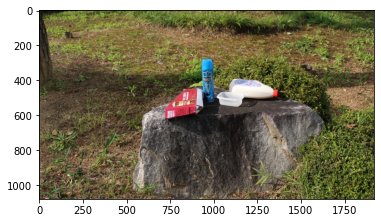

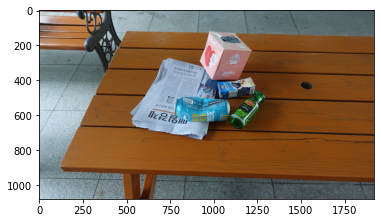

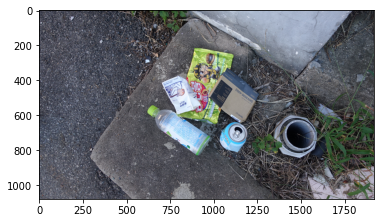

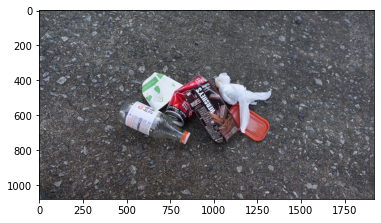

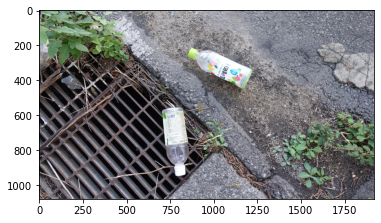

In [23]:
for i in range(10,31):
  img=Image.open('/content/drive/MyDrive/DATA/dataset_4차_트랙3_sample/t3_00{}.JPG'.format(i))
  imshow(np.asarray(img))
  plt.show()

In [ ]:
sample_image_path='/content/drive/MyDrive/DATA/dataset_4차_트랙3_sample/t3_0001.JPG'

with tfv.Graph().as_default():
    image_string_placeholder = tfv.placeholder(tf.string)
    decoded_image = tfv.image.decode_jpeg(image_string_placeholder)
    decoded_image_float = tfv.image.convert_image_dtype(
        image=decoded_image, dtype=tfv.float32
    )
    image_tensor = tfv.expand_dims(decoded_image_float, 0)

    model_url = "https://tfhub.dev/google/openimages_v4/ssd/mobilenet_v2/1"
    detector = hub.Module(model_url)
    detector_output = detector(image_tensor, as_dict=True)
    
    init_ops = [tfv.global_variables_initializer(), tfv.tables_initializer()]
    sess = tfv.Session()
    sess.run(init_ops)

    with tfv.gfile.Open(sample_image_path, "rb") as binfile:
        image_string = binfile.read()

    result_out, image_out = sess.run(
        [detector_output, decoded_image],
        feed_dict={image_string_placeholder: image_string}
    )

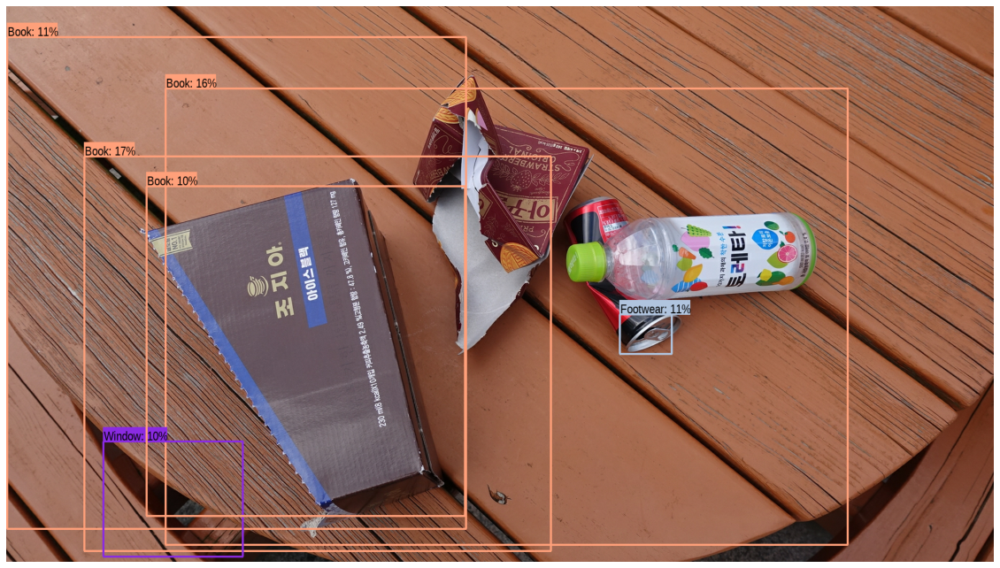

In [32]:
image_with_boxes = draw_boxes(
    np.array(image_out), result_out["detection_boxes"],
    result_out["detection_class_entities"], result_out["detection_scores"]
)
display_image(image_with_boxes)

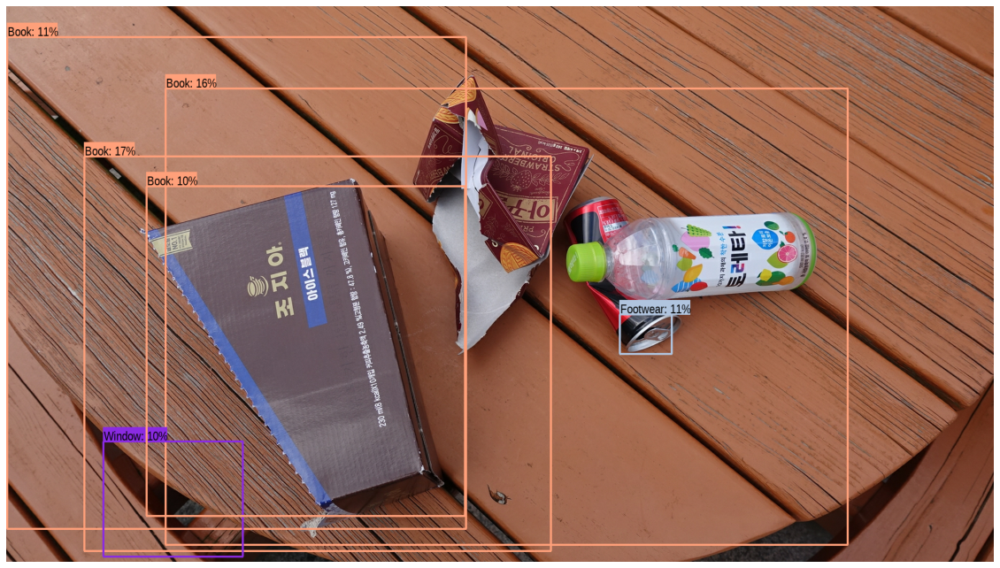

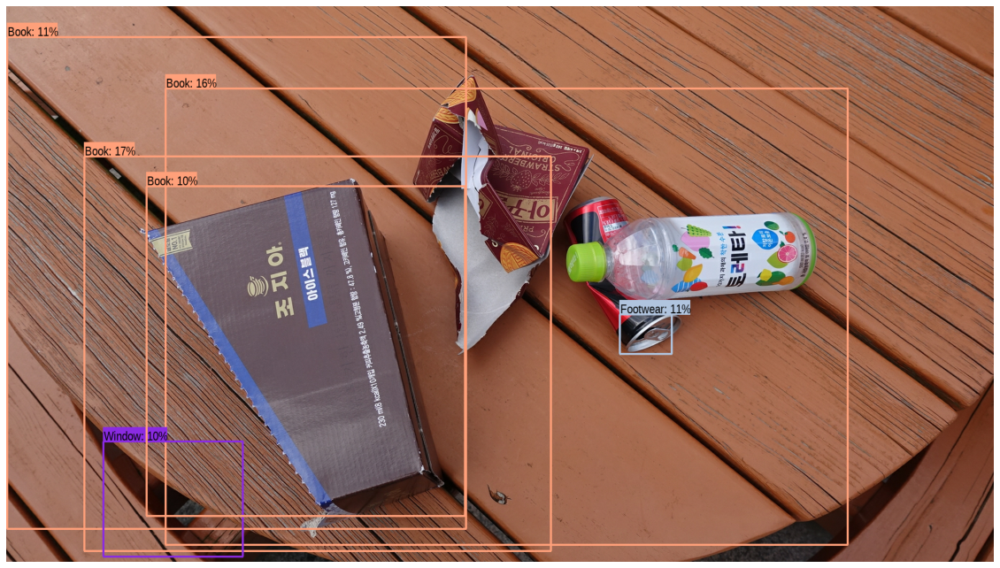

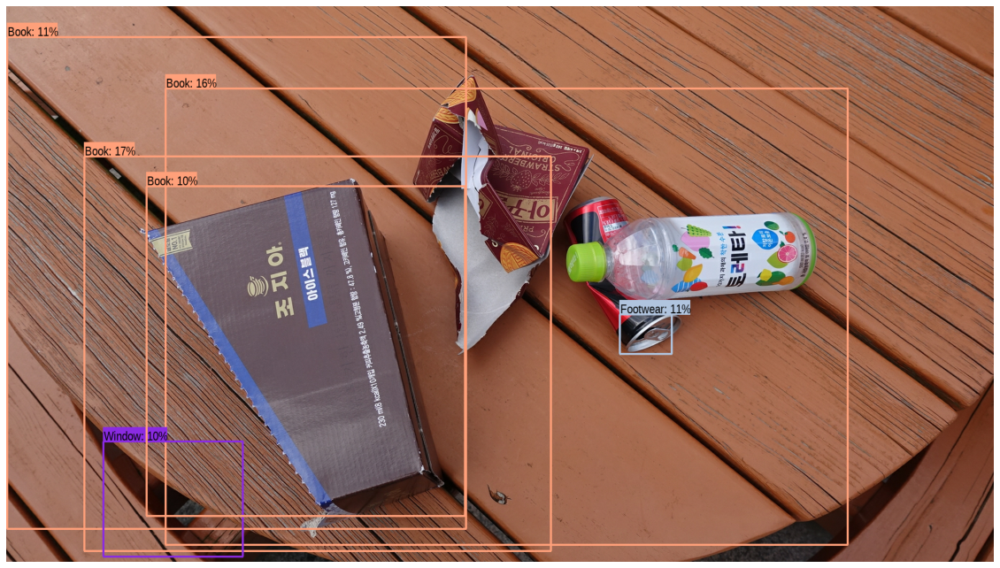

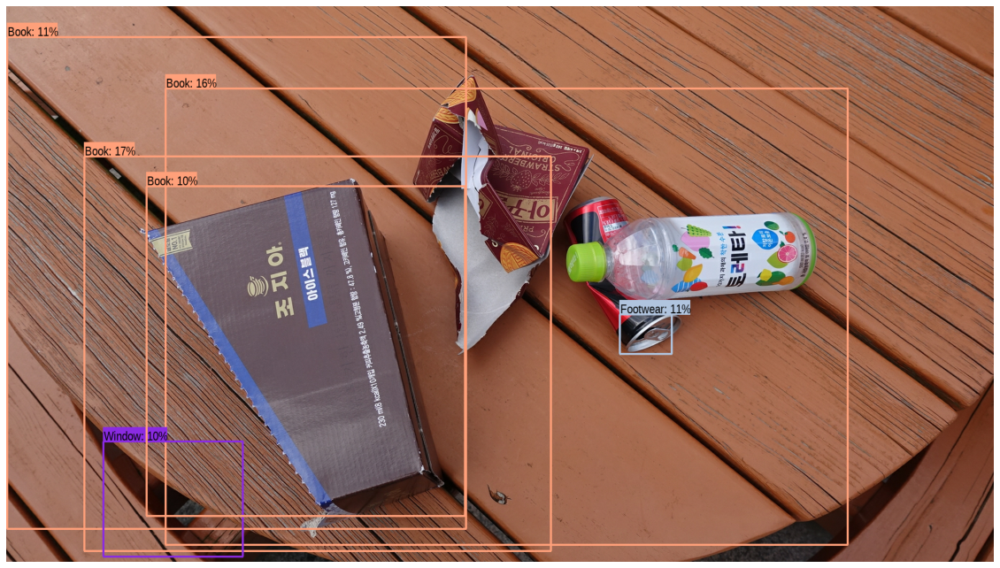

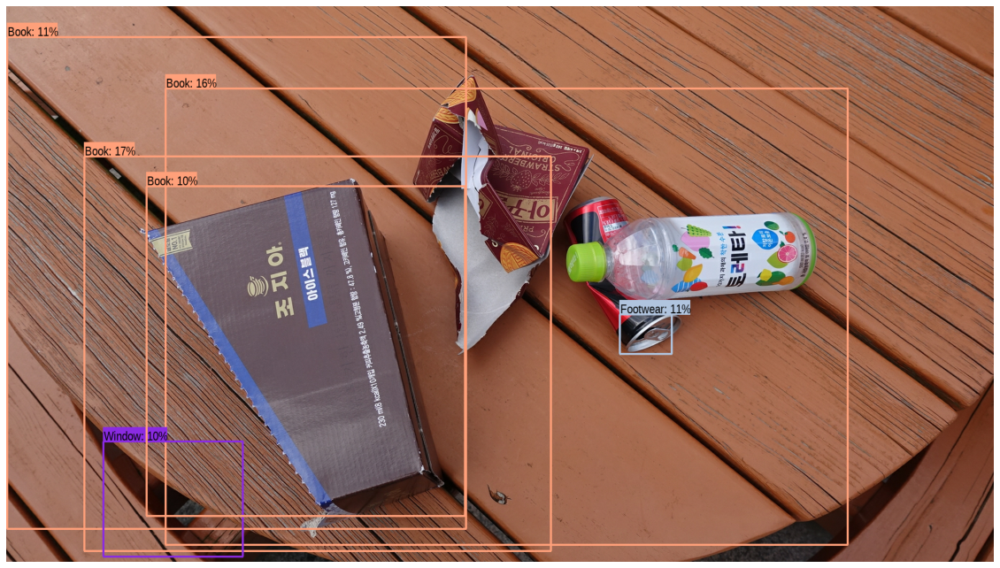

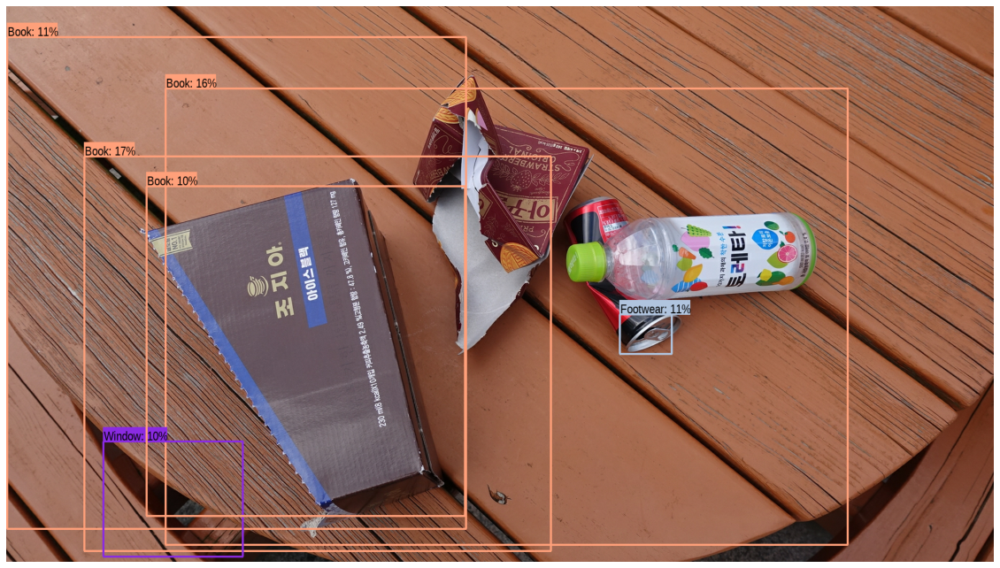

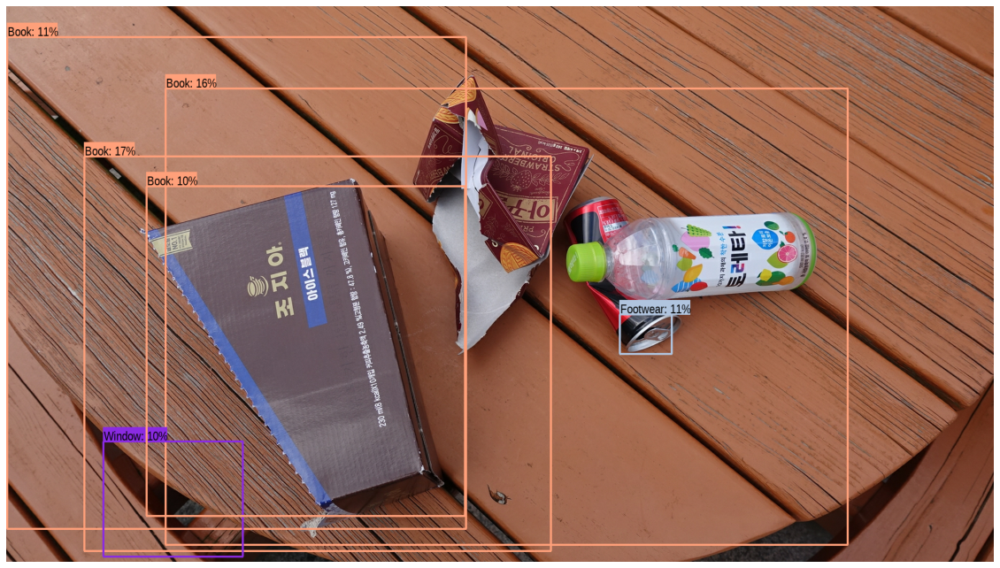

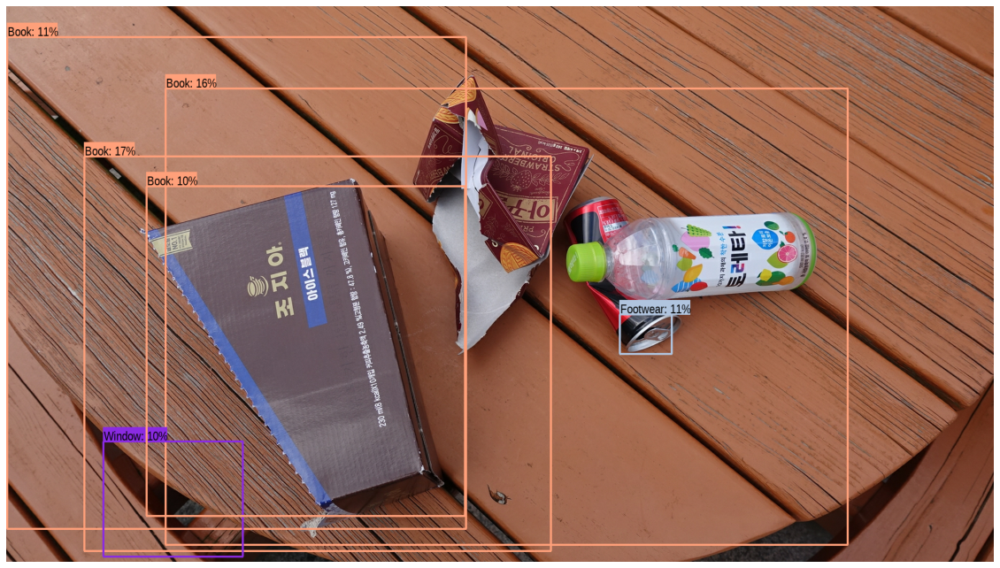

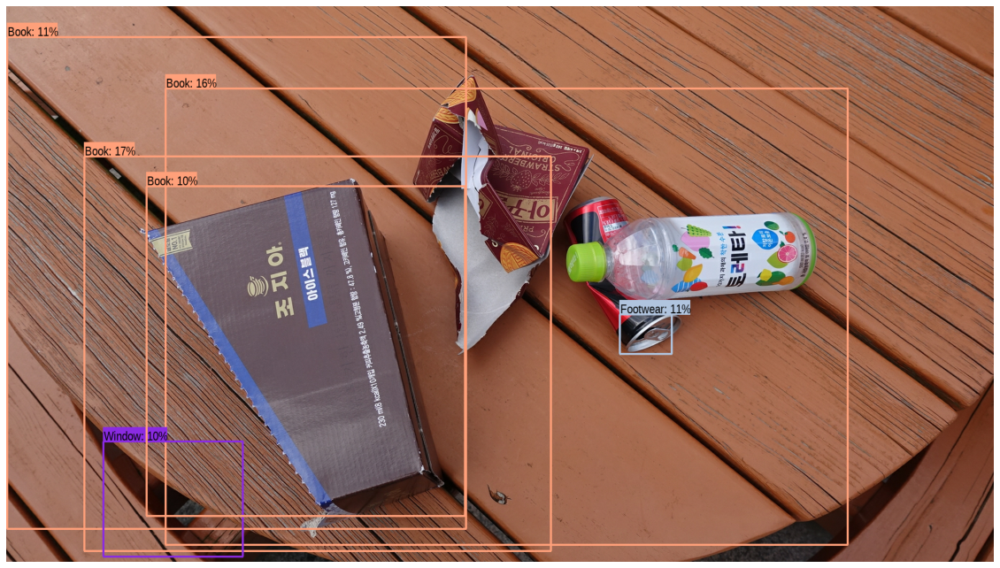

In [38]:
for i in range(1,10):
  sample_image_path='/content/drive/MyDrive/DATA/dataset_4차_트랙3_sample/t3_000{}.JPG'.format(i)
  image_with_boxes = draw_boxes(
    np.array(image_out), result_out["detection_boxes"],
    result_out["detection_class_entities"], result_out["detection_scores"])
  display_image(image_with_boxes)
  i+=1

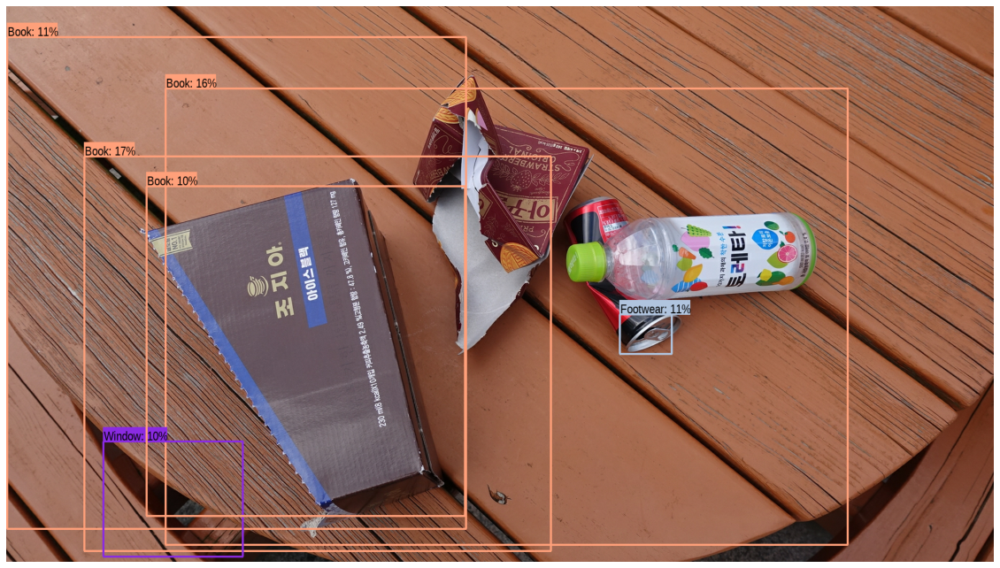

In [ ]:
for i in range(10,31):
  sample_image_path='/content/drive/MyDrive/DATA/dataset_4차_트랙3_sample/t3_00{}.JPG'.format(i)
  image_with_boxes = draw_boxes(
    np.array(image_out), result_out["detection_boxes"],
    result_out["detection_class_entities"], result_out["detection_scores"])
  display_image(image_with_boxes)
  i+=1